# Significant Earthquakes, 1965-2016
RUPESH SHRESTHA (L20528028)


Date, time, and location of all earthquakes with magnitude of 5.5 or higher


This dataset includes a record of the date, time, location, depth, magnitude, and source of every earthquake with a reported magnitude 5.5 or higher since 1965.

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from pandas.plotting import autocorrelation_plot
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as ex
import plotly.graph_objs as go
import plotly.offline as pyo
from plotly.subplots import make_subplots

In [9]:
#reading the datafile 
database = pd.read_csv('database.csv')

In [10]:
database.head()

,Date,Time,Latitude,Longitude,Type,Depth,Depth Error,Depth Seismic Stations,Magnitude,Magnitude Type,...,Magnitude Seismic Stations,Azimuthal Gap,Horizontal Distance,Horizontal Error,Root Mean Square,ID,Source,Location Source,Magnitude Source,Status
0,01/02/1965,13:44:18,19.246,145.616,Earthquake,131.6,NaN,NaN,6.0,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860706,ISCGEM,ISCGEM,ISCGEM,Automatic
1,01/04/1965,11:29:49,1.863,127.352,Earthquake,80.0,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860737,ISCGEM,ISCGEM,ISCGEM,Automatic
2,01/05/1965,18:05:58,-20.579,-173.972,Earthquake,20.0,NaN,NaN,6.2,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860762,ISCGEM,ISCGEM,ISCGEM,Automatic
3,01/08/1965,18:49:43,-59.076,-23.557,Earthquake,15.0,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860856,ISCGEM,ISCGEM,ISCGEM,Automatic
4,01/09/1965,13:32:50,11.938,126.427,Earthquake,15.0,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860890,ISCGEM,ISCGEM,ISCGEM,Automatic


# DATA PREPROCESSING

In [11]:
missing = database.isna().sum()
missing = missing[missing>0]
missing = missing.reset_index()
tr = go.Bar(x=missing['index'],y=missing[0],name='Missing')
tr2 = go.Bar(x=missing['index'],y=[database.shape[0]]*len(missing['index']),name='Total')

data = [tr2,tr]
fig = go.Figure(data=data,layout={'title':'Proportion Of Missing Values In Our Dataset','barmode':'overlay'})
fig.show()

In [12]:
database



,Date,Time,Latitude,Longitude,Type,Depth,Depth Error,Depth Seismic Stations,Magnitude,Magnitude Type,...,Magnitude Seismic Stations,Azimuthal Gap,Horizontal Distance,Horizontal Error,Root Mean Square,ID,Source,Location Source,Magnitude Source,Status
0,01/02/1965,13:44:18,19.2460,145.6160,Earthquake,131.60,NaN,NaN,6.0,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860706,ISCGEM,ISCGEM,ISCGEM,Automatic
1,01/04/1965,11:29:49,1.8630,127.3520,Earthquake,80.00,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860737,ISCGEM,ISCGEM,ISCGEM,Automatic
2,01/05/1965,18:05:58,-20.5790,-173.9720,Earthquake,20.00,NaN,NaN,6.2,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860762,ISCGEM,ISCGEM,ISCGEM,Automatic
3,01/08/1965,18:49:43,-59.0760,-23.5570,Earthquake,15.00,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860856,ISCGEM,ISCGEM,ISCGEM,Automatic
4,01/09/1965,13:32:50,11.9380,126.4270,Earthquake,15.00,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860890,ISCGEM,ISCGEM,ISCGEM,Automatic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23407,12/28/2016,08:22:12,38.3917,-118.8941,Earthquake,12.30,1.2,40.0,5.6,ML,...,18.0,42.47,0.120,NaN,0.1898,NN00570710,NN,NN,NN,Reviewed
23408,12/28/2016,09:13:47,38.3777,-118.8957,Earthquake,8.80,2.0,33.0,5.5,ML,...,18.0,48.58,0.129,NaN,0.2187,NN00570744,NN,NN,NN,Reviewed
23409,12/28/2016,12:38:51,36.9179,140.4262,Earthquake,10.00,1.8,NaN,5.9,MWW,...,NaN,91.00,0.992,4.8,1.5200,US10007NAF,US,US,US,Reviewed
23410,12/29/2016,22:30:19,-9.0283,118.6639,Earthquake,79.00,1.8,NaN,6.3,MWW,...,NaN,26.00,3.553,6.0,1.4300,US10007NL0,US,US,US,Reviewed


In [13]:
#Tackle Missing Values
database['Magnitude Type'] = database['Magnitude Type'].fillna(database['Magnitude Type'].mode()[0])

missing = database.isna().sum()
missing = missing[missing>0]
missing = missing.reset_index()
not_missing = [col for col in database.columns if col not in missing['index'].values]

C:\ana\lib\site-packages\pandas\core\frame.py:3607: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [15]:
Info = database.describe()
Info.loc['kurt'] = database.kurt()
Info.loc['skew'] = database.skew()
Info

C:\ana\lib\site-packages\ipykernel_launcher.py:2: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.

C:\ana\lib\site-packages\ipykernel_launcher.py:3: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



,Latitude,Longitude,Depth,Magnitude,Day_of_Week,Month,Year
count,23412.000000,23412.000000,23412.000000,23412.000000,23412.000000,23412.000000,23412.000000
mean,1.679033,39.639961,70.767911,5.882531,3.005254,6.537887,1992.632411
std,30.113183,125.511959,122.651898,0.423066,1.995514,3.454541,14.426100
min,-77.080000,-179.997000,-1.100000,5.500000,0.000000,1.000000,1965.000000
25%,-18.653000,-76.349750,14.522500,5.600000,1.000000,4.000000,1981.000000
50%,-3.568500,103.982000,33.000000,5.700000,3.000000,7.000000,1993.000000
75%,26.190750,145.026250,54.000000,6.000000,5.000000,10.000000,2005.000000
max,86.005000,179.998000,700.000000,9.100000,6.000000,12.000000,2016.000000
kurt,-0.602892,-1.249877,10.456851,4.388922,-1.245853,-1.227432,-1.109653
skew,0.101804,-0.600646,3.290683,1.848346,-0.009141,-0.005811,-0.166010


In [18]:
f_data = database.copy().rename(columns={'Date':'date'})
partitions = []
partitions.append(f_data.loc[44:int(len(f_data)/3)-1,:])
partitions.append(f_data.loc[int(len(f_data)/3):2*int(len(f_data)/3)-1,:])
partitions.append(f_data.loc[2*int(len(f_data)/3):3*int(len(f_data)/3),:])


neg_part_means =[]
neg_part_std   =[]
pos_part_means =[]
pos_part_std   =[]
for part in partitions:
    neg_part_means.append(part['Magnitude'].mean())
    neg_part_std.append(part['Magnitude'].std())
    pos_part_means.append(part['Depth'].mean())
    pos_part_std.append(part['Depth'].std())
    
res_df = pd.DataFrame({'Depth Mean':pos_part_means,'Magnitude Mean':neg_part_means,'Depth SD':pos_part_std,'Magnitude SD':neg_part_std},
                     index = [f'Partition_{i}' for i in range(1,4)])



res_df


,Depth Mean,Magnitude Mean,Depth SD,Magnitude SD
Partition_1,72.534204,5.893951,116.336975,0.422530
Partition_2,75.496109,5.873746,127.363053,0.416294
Partition_3,64.360249,5.879067,123.777427,0.428495


In [19]:
fig = make_subplots(rows=3, cols=2)

for idx,prt in enumerate(partitions):
    fig.add_trace(
    go.Scatter(x=prt['date'], y=prt['Depth'],name=f'Depth Part {idx+1}'),
    row=idx+1, col=1)
    fig.add_trace(
    go.Scatter(x=prt['date'], y=prt['Magnitude'],name=f'Magnitude Part {idx+1}'),
    row=idx+1, col=2)

fig.update_layout(height=600, width=900, title_text="Distibution Of Yearly Magnitude/Deapth Over Our Time Line For Each Partition")
fig.show()

In [21]:
tmp = database.groupby(by='Year').count()
tmp = tmp.reset_index()[['Year','Date']]
tmp
fig = ex.line(tmp,x='Year',y='Date')
fig.update_layout(
    title= 'Number Of Earthquakes Over The Years 1965-1966',
    xaxis = dict(
        tickmode = 'linear',
        tick0 = 0.0,
        dtick = 1
    )
)
fig.add_shape(type="line",
    x0=tmp['Year'].values[0], y0=tmp['Date'].mean(), x1=tmp['Year'].values[-1], y1=tmp['Date'].mean(),
    line=dict(
        color="Red",
        width=2,
        dash="dashdot",
    ),
        name='Mean'
)
fig.show()

In [22]:
tmp = database.groupby(by='Year').std()
tmp = tmp.reset_index()[['Year','Magnitude']]
tmp
fig = ex.line(tmp,x='Year',y='Magnitude')
fig.update_layout(
    title= 'Earthquake Standard Deviation From The Mean Over The Years 1965-1966, Mean SD Shown With Red Line',
    xaxis = dict(
        tickmode = 'linear',
        tick0 = 0.0,
        dtick = 1
    )
)
fig.add_shape(
        # Line Horizontal
            type="line",
            x0=1965,
            y0=tmp['Magnitude'].mean(),
            x1=2016,
            y1=tmp['Magnitude'].mean(),
            line=dict(
                color="red",
                width=2.5,
                dash="dashdot",
            ),
    )
fig.show()

In [23]:
tmp = database[['Year','Day_of_Week']]
tmp=tmp.groupby(by='Year').agg(lambda x:x.value_counts().index[0])
tmp = tmp.reset_index()
days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday',
            'Sunday']
days = {k:days[k] for k in range(0,7)}
tmp['Day_of_Week'] = tmp['Day_of_Week'].replace(days)
fig = ex.pie(tmp,names='Day_of_Week',title='Propotion Of Earthquakes On A Certian Day Of Week Over The Years ')
fig.show()

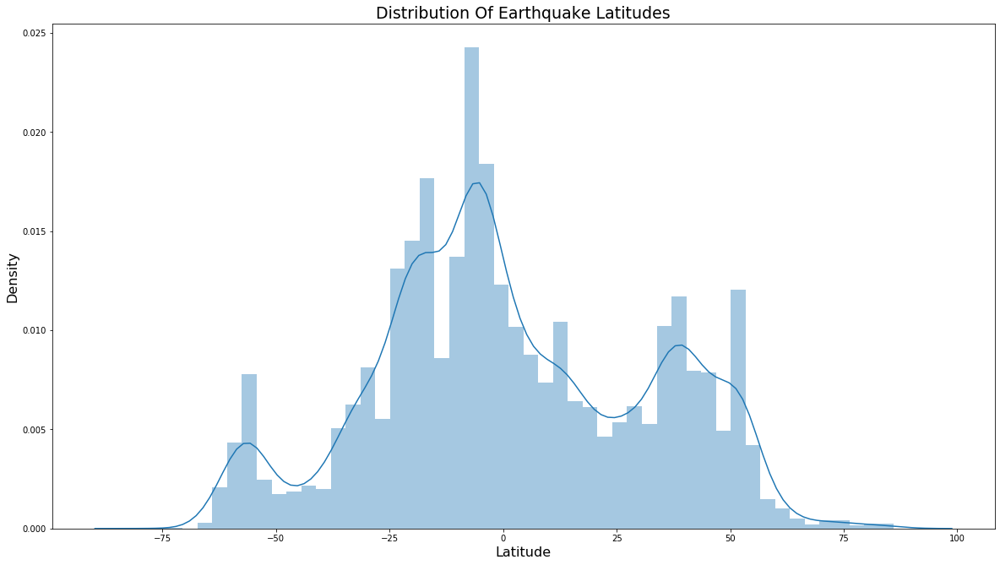

In [24]:
plt.figure(figsize=(20,11))
ax = sns.distplot(database['Latitude'],label='Latitude')
ax.set_title('Distribution Of Earthquake Latitudes',fontsize=19)
ax.set_ylabel('Density',fontsize=16)
ax.set_xlabel('Latitude',fontsize=16)

plt.show()

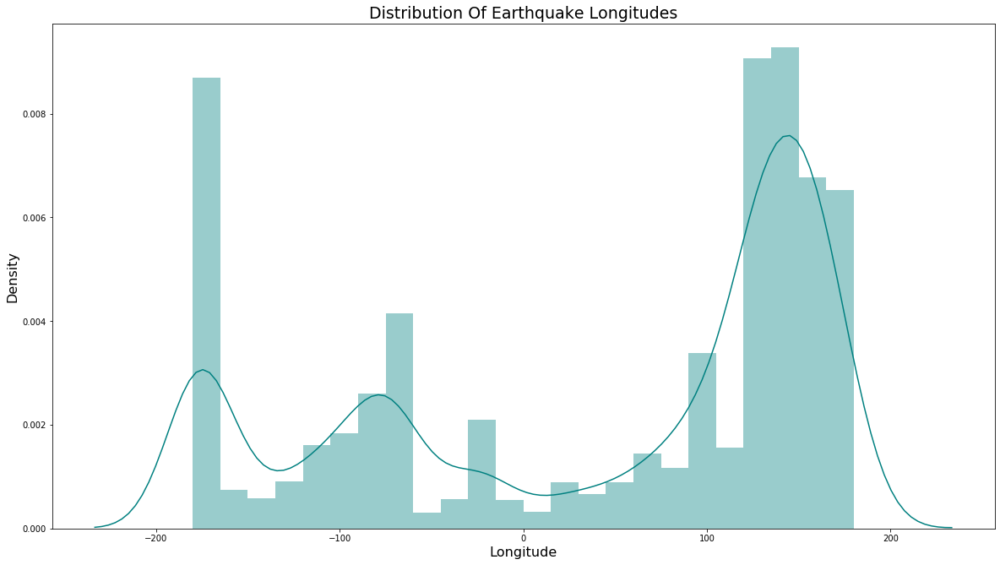

In [25]:

plt.figure(figsize=(20,11))
ax = sns.distplot(database['Longitude'],label='Longitude',color='teal')
ax.set_title('Distribution Of Earthquake Longitudes',fontsize=19)
ax.set_ylabel('Density',fontsize=16)
ax.set_xlabel('Longitude',fontsize=16)

plt.show()

In [26]:
database

,Date,Time,Latitude,Longitude,Type,Depth,Magnitude,Magnitude Type,ID,Source,Location Source,Magnitude Source,Status,Day_of_Week,Month,Year
0,1965-01-02 00:00:00,13:44:18,19.2460,145.6160,Earthquake,131.60,6.0,MW,ISCGEM860706,ISCGEM,ISCGEM,ISCGEM,Automatic,5,1,1965
1,1965-01-04 00:00:00,11:29:49,1.8630,127.3520,Earthquake,80.00,5.8,MW,ISCGEM860737,ISCGEM,ISCGEM,ISCGEM,Automatic,0,1,1965
2,1965-01-05 00:00:00,18:05:58,-20.5790,-173.9720,Earthquake,20.00,6.2,MW,ISCGEM860762,ISCGEM,ISCGEM,ISCGEM,Automatic,1,1,1965
3,1965-01-08 00:00:00,18:49:43,-59.0760,-23.5570,Earthquake,15.00,5.8,MW,ISCGEM860856,ISCGEM,ISCGEM,ISCGEM,Automatic,4,1,1965
4,1965-01-09 00:00:00,13:32:50,11.9380,126.4270,Earthquake,15.00,5.8,MW,ISCGEM860890,ISCGEM,ISCGEM,ISCGEM,Automatic,5,1,1965
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23407,2016-12-28 00:00:00,08:22:12,38.3917,-118.8941,Earthquake,12.30,5.6,ML,NN00570710,NN,NN,NN,Reviewed,2,12,2016
23408,2016-12-28 00:00:00,09:13:47,38.3777,-118.8957,Earthquake,8.80,5.5,ML,NN00570744,NN,NN,NN,Reviewed,2,12,2016
23409,2016-12-28 00:00:00,12:38:51,36.9179,140.4262,Earthquake,10.00,5.9,MWW,US10007NAF,US,US,US,Reviewed,2,12,2016
23410,2016-12-29 00:00:00,22:30:19,-9.0283,118.6639,Earthquake,79.00,6.3,MWW,US10007NL0,US,US,US,Reviewed,3,12,2016


In [28]:
from sklearn.cluster import KMeans,DBSCAN
DB = DBSCAN(eps=0.5,min_samples=15)
c_data = database.copy()
DB.fit(database[['Magnitude','Depth']])
c_data['Cluster'] = DB.labels_

fig = ex.scatter(c_data,x='Longitude',y='Depth',color='Cluster',height=900)
fig.show()

In [29]:
database.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23412 entries, 0 to 23411
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Date              23412 non-null  object 
 1   Time              23412 non-null  object 
 2   Latitude          23412 non-null  float64
 3   Longitude         23412 non-null  float64
 4   Type              23412 non-null  object 
 5   Depth             23412 non-null  float64
 6   Magnitude         23412 non-null  float64
 7   Magnitude Type    23412 non-null  object 
 8   ID                23412 non-null  object 
 9   Source            23412 non-null  object 
 10  Location Source   23412 non-null  object 
 11  Magnitude Source  23412 non-null  object 
 12  Status            23412 non-null  object 
 13  Day_of_Week       23412 non-null  int64  
 14  Month             23412 non-null  int64  
 15  Year              23412 non-null  int64  
dtypes: float64(4), int64(3), object(9)
memor

In [30]:
database['Time'].unique()

array(['13:44:18', '11:29:49', '18:05:58', ..., '12:38:51', '22:30:19',
       '20:08:28'], dtype=object)

In [31]:
database['Type'].unique()

array(['Earthquake', 'Nuclear Explosion', 'Explosion', 'Rock Burst'],
      dtype=object)

In [33]:
database["Type"].replace ({
    'Earthquake': 0,
    'Nuclear Explosion': 1,
    'Explosion' : 2,
    'Rock Burst': 3

        
}, inplace=True)

In [34]:
database['Magnitude Type'].unique()

array(['MW', 'ML', 'MH', 'MS', 'MB', 'MWC', 'MD', 'MWB', 'MWW', 'MWR'],
      dtype=object)

In [35]:
database["Magnitude Type"].replace ({
    'MW':0, 
    'ML':1, 
    'MH':2, 
    'MS':3, 
    'MB':4, 
    'MWC':5, 
    'MD':6, 
    'MWB':7, 
    'MWW':8,
    'MWR':9


        
}, inplace=True)

In [36]:
database['ID'].unique()

array(['ISCGEM860706', 'ISCGEM860737', 'ISCGEM860762', ..., 'US10007NAF',
       'US10007NL0', 'US10007NTD'], dtype=object)

In [37]:
database['Source'].unique()

array(['ISCGEM', 'ISCGEMSUP', 'OFFICIAL', 'CI', 'US', 'NC', 'GCMT', 'UW',
       'ATLAS', 'NN', 'SE', 'AK', 'PR'], dtype=object)

In [38]:
database['Location Source'].unique()

array(['ISCGEM', 'CI', 'US', 'H', 'U', 'G', 'NC', 'B', 'GCMT', 'AG', 'UW',
       'SPE', 'HVO', 'BRK', 'ATLAS', 'AGS', 'PGC', 'BOU', 'SLC', 'OTT',
       'AEI', 'AEIC', 'CASC', 'ISK', 'ATH', 'THE', 'ROM', 'MDD', 'WEL',
       'GUC', 'UNM', 'CSEM', 'RSPR', 'JMA', 'NN', 'CAR', 'SJA', 'TEH',
       'BEO', 'UCR', 'SE', 'TUL', 'TAP', 'THR', 'LIM', 'US_WEL', 'AK',
       'PR'], dtype=object)

In [39]:
database['Magnitude Source'].unique()

array(['ISCGEM', 'OFFICIAL', 'CI', 'US', '1020', 'BRK', 'NC', '1000',
       'GCMT', '1009', 'UW', '1023', 'ATLAS', 'HRV', 'PAR', 'NIED', 'NN',
       'SE', 'PGC', 'US_GCMT', 'US_PGC', 'AK', 'PR', 'GUC'], dtype=object)

In [40]:
database['Status'].unique()

array(['Automatic', 'Reviewed'], dtype=object)

In [41]:
database["Status"].replace ({
    'Automatic': 0,
    'Reviewed': 1
   

        
}, inplace=True)

In [43]:
database.drop()

SyntaxError: invalid syntax (<ipython-input-43-6b35d831c27a>, line 1)

In [47]:
database.drop(['Location Source','Source','Magnitude Source','ID','Date','Time'], axis=1 ,inplace=True)

C:\ana\lib\site-packages\pandas\core\frame.py:4908: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [48]:
database

,Latitude,Longitude,Type,Depth,Magnitude,Magnitude Type,Status,Day_of_Week,Month,Year
0,19.2460,145.6160,0,131.60,6.0,0,0,5,1,1965
1,1.8630,127.3520,0,80.00,5.8,0,0,0,1,1965
2,-20.5790,-173.9720,0,20.00,6.2,0,0,1,1,1965
3,-59.0760,-23.5570,0,15.00,5.8,0,0,4,1,1965
4,11.9380,126.4270,0,15.00,5.8,0,0,5,1,1965
...,...,...,...,...,...,...,...,...,...,...
23407,38.3917,-118.8941,0,12.30,5.6,1,1,2,12,2016
23408,38.3777,-118.8957,0,8.80,5.5,1,1,2,12,2016
23409,36.9179,140.4262,0,10.00,5.9,8,1,2,12,2016
23410,-9.0283,118.6639,0,79.00,6.3,8,1,3,12,2016


In [49]:
# Loading Clustering model
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN

In [51]:
x_data = database [['Latitude','Longitude','Depth','Magnitude']]

In [52]:
x_data.head(5)

,Latitude,Longitude,Depth,Magnitude
0,19.246,145.616,131.6,6.0
1,1.863,127.352,80.0,5.8
2,-20.579,-173.972,20.0,6.2
3,-59.076,-23.557,15.0,5.8
4,11.938,126.427,15.0,5.8


In [53]:
x_data = x_data.apply(lambda x: (x - x.min(axis=0)) / (x.max(axis=0) - x.min(axis=0)))

In [54]:
x_data.head()

,Latitude,Longitude,Depth,Magnitude
0,0.590649,0.904493,0.189274,0.138889
1,0.484060,0.853759,0.115675,0.083333
2,0.346451,0.016736,0.030096,0.194444
3,0.110396,0.434562,0.022964,0.083333
4,0.545838,0.851190,0.022964,0.083333


In [55]:
# Using k=2 for number of cluster
model = KMeans(n_clusters=2)
model.fit(x_data)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=2, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [56]:
#Check centroids of model
centroids = model.cluster_centers_
print(centroids)

[[0.41185807 0.18540807 0.11658506 0.10123787]
 [0.5248243  0.86043511 0.09420983 0.10921777]]


In [57]:
x_data.mean()

Latitude     0.482932
Longitude    0.610111
Depth        0.102507
Magnitude    0.106259
dtype: float64

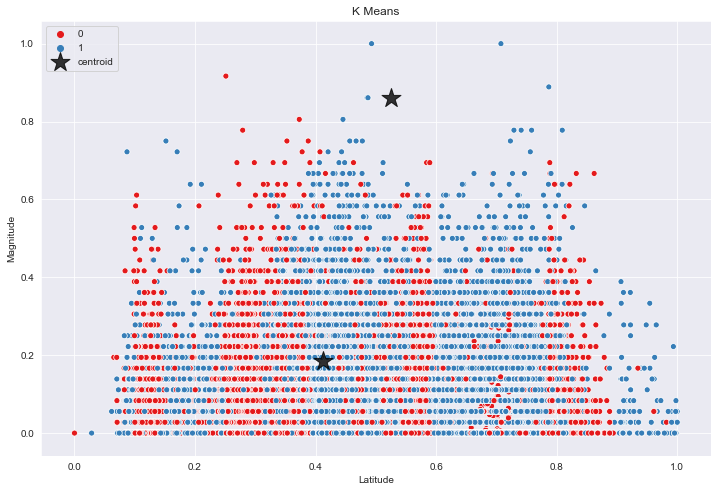

In [58]:
#Scatter plot between any two attibute kmean =2
sns.set_style('darkgrid')
plt.figure(figsize=(12,8))
plt.title('K Means')
sns.scatterplot(x='Latitude',y='Magnitude',data=x_data,hue=model.labels_,palette='Set1')
#Define the centers of the clusters    
centers = model.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=400, alpha=0.8,marker='*',label='centroid')
plt.legend(loc=2)

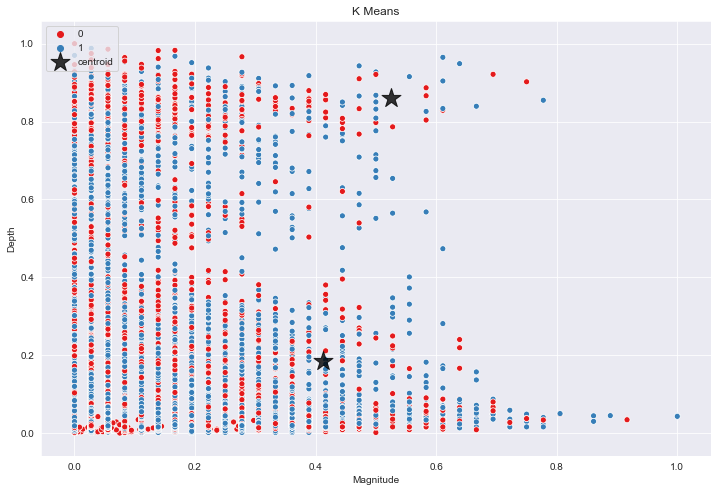

In [59]:
#Scatter plot between any two attibute kmean =2
sns.set_style('darkgrid')
plt.figure(figsize=(12,8))
plt.title('K Means')
sns.scatterplot(x='Magnitude',y='Depth',data=x_data,hue=model.labels_,palette='Set1')
#Define the centers of the clusters    
centers = model.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=400, alpha=0.8,marker='*',label='centroid')
plt.legend(loc=2)

In [60]:
DB = DBSCAN(eps=0.5,min_samples=15)
c_data = x_data.copy()
DB.fit(database[['Magnitude','Depth']])
c_data['Cluster'] = DB.labels_

fig = ex.scatter(c_data,x='Longitude',y='Depth',color='Cluster',height=900)
fig.show()

In [61]:
y_data = database [['Latitude','Longitude','Depth','Magnitude']]

In [62]:
y_data

,Latitude,Longitude,Depth,Magnitude
0,19.2460,145.6160,131.60,6.0
1,1.8630,127.3520,80.00,5.8
2,-20.5790,-173.9720,20.00,6.2
3,-59.0760,-23.5570,15.00,5.8
4,11.9380,126.4270,15.00,5.8
...,...,...,...,...
23407,38.3917,-118.8941,12.30,5.6
23408,38.3777,-118.8957,8.80,5.5
23409,36.9179,140.4262,10.00,5.9
23410,-9.0283,118.6639,79.00,6.3


In [63]:
# Scaleing data to same standard scale with mean '0' and std '1'
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
data = y_data.copy()
data[data.columns] = scaler.fit_transform(data)

In [64]:
data

,Latitude,Longitude,Depth,Magnitude
0,0.583377,0.844368,0.495984,0.277668
1,0.006109,0.698849,0.075272,-0.195082
2,-0.739162,-1.701962,-0.413928,0.750418
3,-2.017599,-0.503524,-0.454694,-0.195082
4,0.340688,0.691479,-0.454694,-0.195082
...,...,...,...,...
23407,1.219182,-1.263126,-0.476708,-0.667832
23408,1.218717,-1.263139,-0.505245,-0.904207
23409,1.170239,0.803018,-0.495461,0.041293
23410,-0.355577,0.629626,0.067119,0.986793


In [65]:
data.describe()

,Latitude,Longitude,Depth,Magnitude
count,2.341200e+04,2.341200e+04,2.341200e+04,2.341200e+04
mean,-1.664291e-16,1.076270e-16,-2.226682e-15,1.907092e-15
std,1.000021e+00,1.000021e+00,1.000021e+00,1.000021e+00
min,-2.615490e+00,-1.749966e+00,-5.859628e-01,-9.042070e-01
25%,-6.752015e-01,-9.241525e-01,-4.585874e-01,-6.678320e-01
50%,-1.742640e-01,5.126477e-01,-3.079342e-01,-4.314570e-01
75%,8.140036e-01,8.396693e-01,-1.367143e-01,2.776679e-01
max,2.800360e+00,1.118308e+00,5.130337e+00,7.605293e+00


In [66]:
data.mean()

Latitude    -1.664291e-16
Longitude    1.076270e-16
Depth       -2.226682e-15
Magnitude    1.907092e-15
dtype: float64

In [67]:
# Loading Clustering model
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN

In [68]:
# Using k=2 for number of cluster
model = KMeans(n_clusters=2)
model.fit(data)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=2, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [69]:
#Check centroids of model
centroids = model.cluster_centers_
print(centroids)

[[ 0.25046509  0.71178403 -0.04791078  0.02516189]
 [-0.42697121 -1.21338785  0.08167415 -0.04289381]]


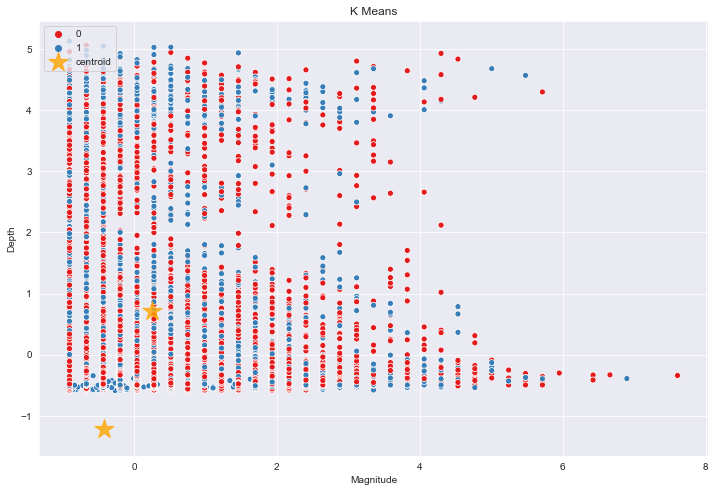

In [70]:
#Scatter plot between any two attibute
sns.set_style('darkgrid')
plt.figure(figsize=(12,8))
plt.title('K Means')
sns.scatterplot(x='Magnitude',y='Depth',data=data,hue=model.labels_,palette='Set1')
#Define the centers of the clusters    
centers = model.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='orange', s=400, alpha=0.8,marker='*',label='centroid')
plt.legend(loc=2)

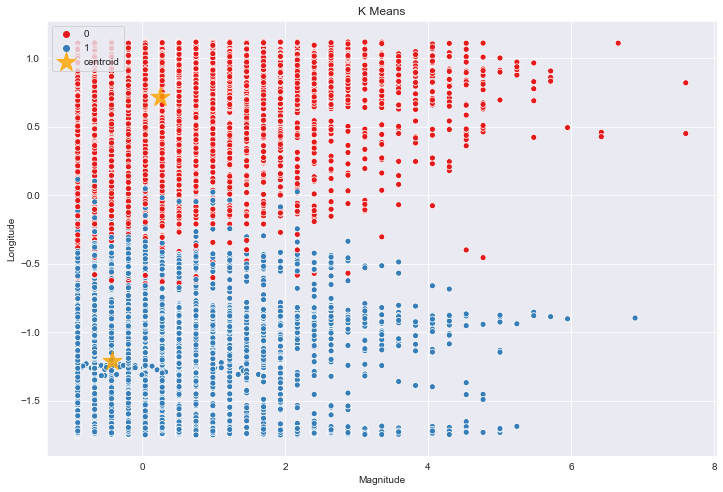

In [71]:
#Scatter plot between any two attibute
sns.set_style('darkgrid')
plt.figure(figsize=(12,8))
plt.title('K Means')
sns.scatterplot(x='Magnitude',y='Longitude',data=data,hue=model.labels_,palette='Set1')
#Define the centers of the clusters    
centers = model.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='orange', s=400, alpha=0.8,marker='*',label='centroid')
plt.legend(loc=2)

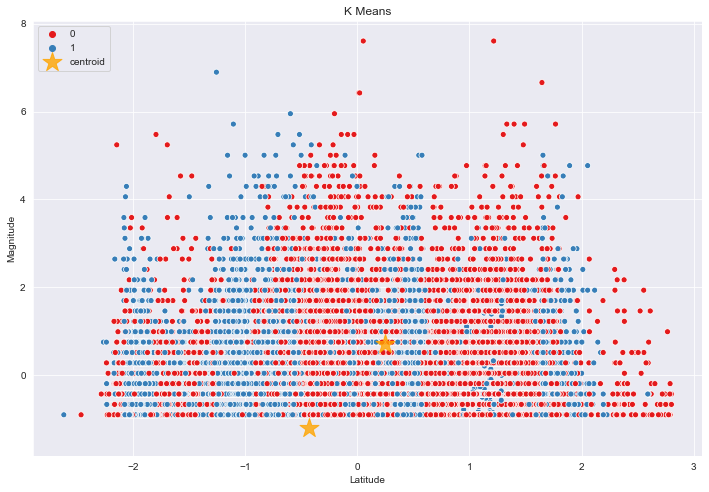

In [72]:
#Scatter plot between any two attibute
sns.set_style('darkgrid')
plt.figure(figsize=(12,8))
plt.title('K Means')
sns.scatterplot(x='Latitude',y='Magnitude',data=data,hue=model.labels_,palette='Set1')
#Define the centers of the clusters    
centers = model.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='orange', s=400, alpha=0.8,marker='*',label='centroid')
plt.legend(loc=2)

In [73]:
# Using k=3 for number of cluster
model = KMeans(n_clusters=3)
model.fit(data)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=3, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [74]:
centroids = model.cluster_centers_
print(centroids)

[[-0.29355849 -0.39309165  3.74515867  0.13274647]
 [ 0.25649423  0.7081403  -0.21580413  0.01481436]
 [-0.40139166 -1.17642547 -0.23427709 -0.04766119]]


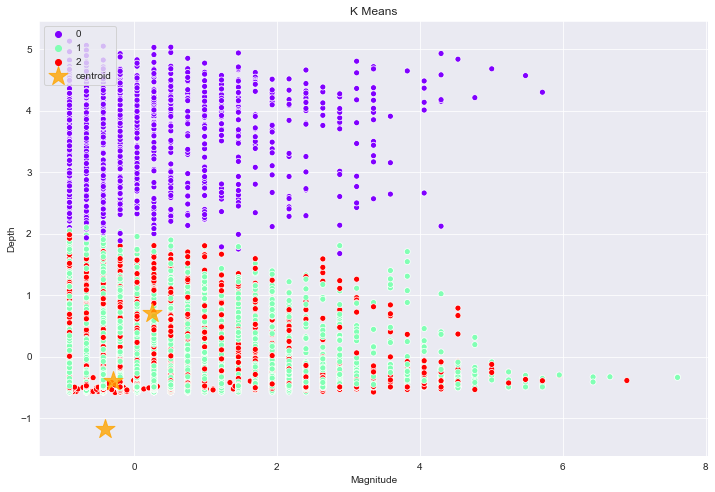

In [76]:
#Scatter plot between any two attibute
sns.set_style('darkgrid')
plt.figure(figsize=(12,8))
plt.title('K Means')
sns.scatterplot(x='Magnitude',y='Depth',data=data,hue=model.labels_,palette='rainbow')
#Define the centers of the clusters    
centers = model.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='orange', s=400, alpha=0.8,marker='*',label='centroid')
plt.legend(loc=2)

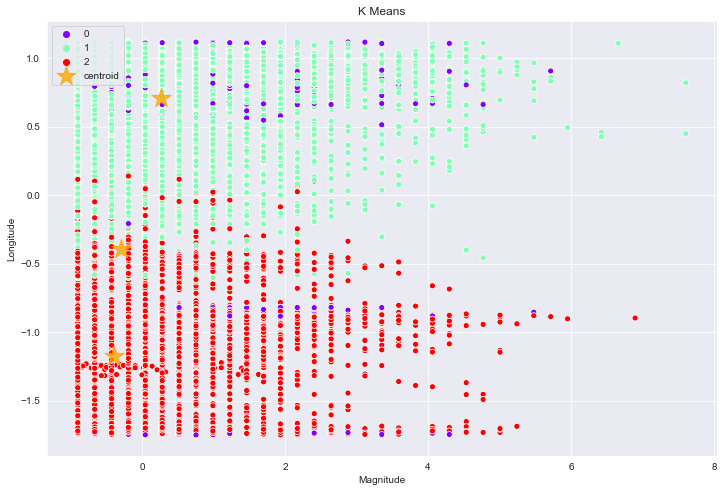

In [77]:
#Scatter plot between any two attibute
sns.set_style('darkgrid')
plt.figure(figsize=(12,8))
plt.title('K Means')
sns.scatterplot(x='Magnitude',y='Longitude',data=data,hue=model.labels_,palette='rainbow')
#Define the centers of the clusters    
centers = model.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='orange', s=400, alpha=0.8,marker='*',label='centroid')
plt.legend(loc=2)

In [78]:
# Using k=5 for number of cluster
model = KMeans(n_clusters=5)
model.fit(data)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=5, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [79]:
center = model.cluster_centers_
print(center)

[[-0.34056717  0.77442796 -0.1879198  -0.31323873]
 [-0.80344843 -1.15586546 -0.20926506 -0.27096081]
 [-0.30589722 -0.41235528  3.77687574  0.09909803]
 [ 1.28241807  0.18275128 -0.27229429 -0.26810163]
 [ 0.16224083  0.20562617 -0.21555996  2.1136536 ]]


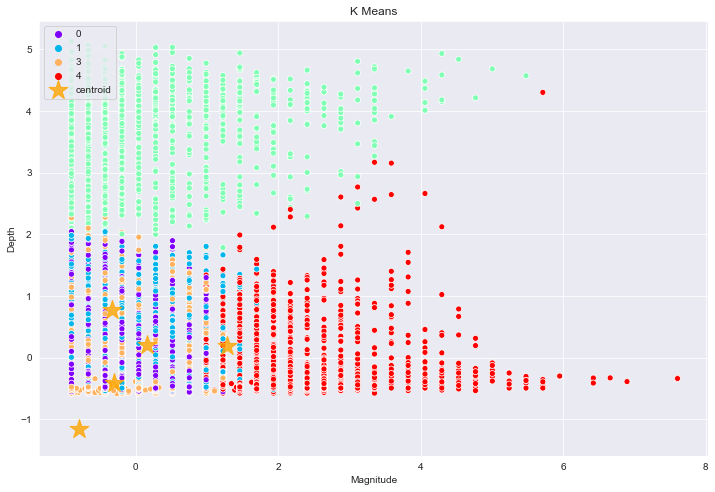

In [80]:
#Scatter plot between any two attibute
sns.set_style('darkgrid')
plt.figure(figsize=(12,8))
plt.title('K Means')
sns.scatterplot(x='Magnitude',y='Depth',data=data,hue=model.labels_,palette='rainbow')
#Define the centers of the clusters    
centers = model.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='orange', s=400, alpha=0.8,marker='*',label='centroid')
plt.legend(loc=2)

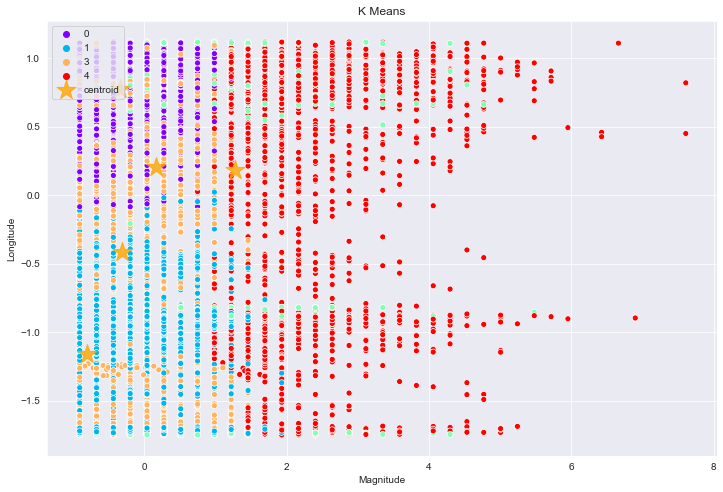

In [81]:
#Scatter plot between any two attibute
sns.set_style('darkgrid')
plt.figure(figsize=(12,8))
plt.title('K Means')
sns.scatterplot(x='Magnitude',y='Longitude',data=data,hue=model.labels_,palette='rainbow')
#Define the centers of the clusters    
centers = model.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='orange', s=400, alpha=0.8,marker='*',label='centroid')
plt.legend(loc=2)

DBSCAN

In [82]:
# Using DBSCAN for clustering
dbscan = DBSCAN(eps=0.5)

In [83]:
# Using DBSCAN for clustering
model = DBSCAN(eps=0.05, min_samples=2).fit(data)
print(model)

DBSCAN(algorithm='auto', eps=0.05, leaf_size=30, metric='euclidean',
       metric_params=None, min_samples=2, n_jobs=None, p=None)


In [91]:
y_data

,Latitude,Longitude,Depth,Magnitude
0,19.2460,145.6160,131.60,6.0
1,1.8630,127.3520,80.00,5.8
2,-20.5790,-173.9720,20.00,6.2
3,-59.0760,-23.5570,15.00,5.8
4,11.9380,126.4270,15.00,5.8
...,...,...,...,...
23407,38.3917,-118.8941,12.30,5.6
23408,38.3777,-118.8957,8.80,5.5
23409,36.9179,140.4262,10.00,5.9
23410,-9.0283,118.6639,79.00,6.3


In [89]:
# Normalize data
from sklearn.preprocessing import normalize 
from sklearn.decomposition import PCA 
data = normalize(database)

In [90]:
database

,Latitude,Longitude,Type,Depth,Magnitude,Magnitude Type,Status,Day_of_Week,Month,Year
0,19.2460,145.6160,0,131.60,6.0,0,0,5,1,1965
1,1.8630,127.3520,0,80.00,5.8,0,0,0,1,1965
2,-20.5790,-173.9720,0,20.00,6.2,0,0,1,1,1965
3,-59.0760,-23.5570,0,15.00,5.8,0,0,4,1,1965
4,11.9380,126.4270,0,15.00,5.8,0,0,5,1,1965
...,...,...,...,...,...,...,...,...,...,...
23407,38.3917,-118.8941,0,12.30,5.6,1,1,2,12,2016
23408,38.3777,-118.8957,0,8.80,5.5,1,1,2,12,2016
23409,36.9179,140.4262,0,10.00,5.9,8,1,2,12,2016
23410,-9.0283,118.6639,0,79.00,6.3,8,1,3,12,2016


In [87]:
new_df = pd.DataFrame(database)

In [88]:
new_df.head()

,Latitude,Longitude,Type,Depth,Magnitude,Magnitude Type,Status,Day_of_Week,Month,Year
0,19.246,145.616,0,131.6,6.0,0,0,5,1,1965
1,1.863,127.352,0,80.0,5.8,0,0,0,1,1965
2,-20.579,-173.972,0,20.0,6.2,0,0,1,1,1965
3,-59.076,-23.557,0,15.0,5.8,0,0,4,1,1965
4,11.938,126.427,0,15.0,5.8,0,0,5,1,1965


In [92]:
x_data

,Latitude,Longitude,Depth,Magnitude
0,0.590649,0.904493,0.189274,0.138889
1,0.484060,0.853759,0.115675,0.083333
2,0.346451,0.016736,0.030096,0.194444
3,0.110396,0.434562,0.022964,0.083333
4,0.545838,0.851190,0.022964,0.083333
...,...,...,...,...
23407,0.708046,0.169733,0.019113,0.027778
23408,0.707960,0.169728,0.014121,0.000000
23409,0.699009,0.890077,0.015832,0.111111
23410,0.417277,0.829625,0.114249,0.222222


In [93]:
# Using DBSCAN for clustering
model = DBSCAN(eps=0.05, min_samples=2).fit(x_data)
print(model)

DBSCAN(algorithm='auto', eps=0.05, leaf_size=30, metric='euclidean',
       metric_params=None, min_samples=2, n_jobs=None, p=None)


In [94]:
#Using PCAand reducing the dimensionality of the data to make it visualizable
pca = PCA(n_components = 2) 
X = pca.fit_transform(x_data) 
new_df = pd.DataFrame(X) 
new_df.columns = ['P1', 'P2'] 
print(new_df.head()) 

         P1        P2
0 -0.301722 -0.000237
1 -0.239611  0.043973
2  0.600191 -0.015592
3  0.223348  0.245342
4 -0.251611 -0.056339


In [95]:
db = DBSCAN(eps = 0.0375, min_samples = 3).fit(x_data) 
labels = db.labels_ 

In [96]:
print(labels)

[ 0  1  2 ...  1 29  1]


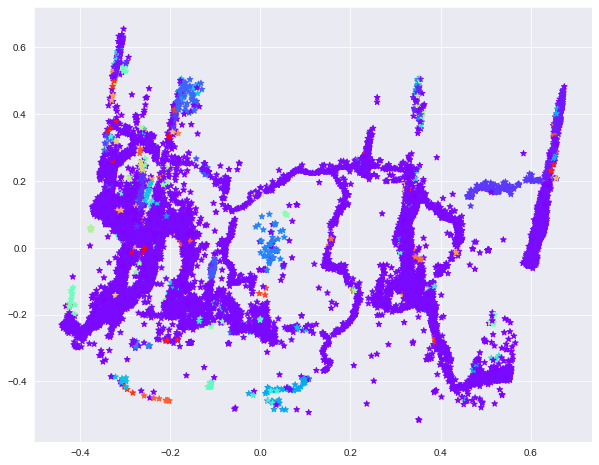

In [97]:
#Plotting the scater plot
plt.figure(figsize =(10, 8)) 
plt.scatter(new_df['P1'], new_df['P2'], c = labels, cmap='rainbow',marker="*")

In [108]:
DB = DBSCAN(eps=0.5,min_samples=15)
c_data = x_data.copy()
DB.fit(database[['Magnitude','Depth']])
c_data['Cluster'] = DB.labels_

fig = ex.scatter(c_data,x='Longitude',y='Depth',color='Cluster',height=900)
fig.show()

In [99]:
DB = DBSCAN(eps=0.5,min_samples=15)
c_data = x_data.copy()
DB.fit(database[['Magnitude','Latitude']])
c_data['Cluster'] = DB.labels_

fig = ex.scatter(c_data,x='',y='Depth',color='Cluster',height=900)
fig.show()

In [106]:
DB = DBSCAN(eps=0.5,min_samples=15)
c_data = x_data.copy()
DB.fit(database[['Magnitude','Longitude']])
c_data['Cluster'] = DB.labels_

fig = ex.scatter(c_data,x='Magnitude',y='Longitude',color='Cluster',height=900)
fig.show()

In [104]:
#Clustring
from sklearn.cluster import KMeans,DBSCAN
DB = DBSCAN(eps=0.5,algorithm='ball_tree',min_samples=15)
c_data = y_data.copy()
DB.fit(y_data[['Magnitude','Depth']])
c_data['Cluster'] = DB.labels_

fig = ex.scatter_3d(c_data,x='Longitude',y='Depth',z='Magnitude',color='Cluster',height=900)
fig.show()

In [107]:
DB = DBSCAN(eps=0.5,min_samples=15)
c_data = x_data.copy()
DB.fit(database[['Magnitude','Longitude']])
c_data['Cluster'] = DB.labels_

fig = ex.scatter(c_data,x='Magnitude',y='Longitude',color='Cluster',height=900)
fig.show()
